# Boston Property Value Prediction
### Author: Meghan Holquist 
##### Summer 2023

Data taken from boston open data website. 
Link to data dictionary: https://data.boston.gov/dataset/property-assessment/resource/4973f23e-859e-4190-b308-8223c246147e

My goals for this project are to simply gain practical modelling experience with a real-world dataset, allowing me to bolster my ML knowledge as well as practice my data cleaning skills. Since I am doing this project for the learning experience, I will be prioritizing predictive power over inference, and thus letting this guide my decisions throughout the project. 

In [13]:
#import all relevant libraries 
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import geopandas as gpd
import plotly.express as px
from urllib.request import urlopen
import json
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import ElasticNet
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import StandardScaler
from IPython.display import Image
import warnings
warnings.filterwarnings('ignore')


In [14]:
#read in the data
housing = pd.read_csv('fy2023-property-assessment-data.csv')

#check head of data
housing.head()

,PID,CM_ID,GIS_ID,ST_NUM,ST_NAME,UNIT_NUM,CITY,ZIP_CODE,BLDG_SEQ,NUM_BLDGS,...,KITCHEN_STYLE2,KITCHEN_STYLE3,HEAT_TYPE,HEAT_FUEL,AC_TYPE,FIREPLACES,ORIENTATION,NUM_PARKING,PROP_VIEW,CORNER_UNIT
0,100001000,NaN,100001000,104.0,PUTNAM ST,NaN,EAST BOSTON,2128.0,1.0,1,...,S - Semi-Modern,S - Semi-Modern,W - Ht Water/Steam,NaN,N - None,0.0,NaN,3.0,A - Average,NaN
1,100002000,NaN,100002000,197.0,Lexington ST,NaN,EAST BOSTON,2128.0,1.0,1,...,M - Modern,M - Modern,F - Forced Hot Air,NaN,C - Central AC,0.0,NaN,0.0,A - Average,NaN
2,100003000,NaN,100003000,199.0,Lexington ST,NaN,EAST BOSTON,2128.0,1.0,1,...,S - Semi-Modern,S - Semi-Modern,S - Space Heat,NaN,N - None,0.0,NaN,0.0,A - Average,NaN
3,100004000,NaN,100004000,201.0,Lexington ST,NaN,EAST BOSTON,2128.0,1.0,1,...,S - Semi-Modern,S - Semi-Modern,W - Ht Water/Steam,NaN,N - None,0.0,NaN,0.0,A - Average,NaN
4,100005000,NaN,100005000,203.0,Lexington ST,NaN,EAST BOSTON,2128.0,1.0,1,...,S - Semi-Modern,NaN,W - Ht Water/Steam,NaN,N - None,0.0,NaN,0.0,A - Average,NaN


In [15]:
#check the shape and data types 
housing.shape
print(housing.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180627 entries, 0 to 180626
Data columns (total 60 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   PID                 180627 non-null  int64  
 1   CM_ID               91160 non-null   float64
 2   GIS_ID              180627 non-null  int64  
 3   ST_NUM              171096 non-null  float64
 4   ST_NAME             180627 non-null  object 
 5   UNIT_NUM            80672 non-null   object 
 6   CITY                180622 non-null  object 
 7   ZIP_CODE            180624 non-null  float64
 8   BLDG_SEQ            180626 non-null  float64
 9   NUM_BLDGS           180627 non-null  int64  
 10  LUC                 180627 non-null  int64  
 11  LU                  180627 non-null  object 
 12  LU_DESC             180627 non-null  object 
 13  BLDG_TYPE           178101 non-null  object 
 14  OWN_OCC             180627 non-null  object 
 15  OWNER               180627 non-nul

### Dealing with Missing Values

In [16]:
#check percent missing values overall: 
print(round(((housing.isnull().sum()/len(housing)) * 100), 2), '%')

PID                     0.0
CM_ID                  50.0
GIS_ID                  0.0
ST_NUM                  5.0
ST_NAME                 0.0
UNIT_NUM               55.0
CITY                    0.0
ZIP_CODE                0.0
BLDG_SEQ                0.0
NUM_BLDGS               0.0
LUC                     0.0
LU                      0.0
LU_DESC                 0.0
BLDG_TYPE               1.0
OWN_OCC                 0.0
OWNER                   0.0
OWNER MAIL ADDRESS      0.0
RES_FLOOR              19.0
CD_FLOOR               61.0
RES_UNITS              94.0
COM_UNITS             100.0
RC_UNITS              100.0
LAND_SF                 4.0
GROSS_AREA             19.0
LIVING_AREA            19.0
LAND_VALUE              0.0
BLDG_VALUE              0.0
TOTAL_VALUE             0.0
GROSS_TAX               0.0
YR_BUILT               13.0
YR_REMODEL             53.0
STRUCTURE_CLASS        91.0
ROOF_STRUCTURE         20.0
ROOF_COVER             20.0
INT_WALL               27.0
EXT_FNISHED         

There are several approaches we can take to dealing with missing values. However, some columns have over 50% missing values, and theres not much we can do with that. Even when there are more than 20% missing values and you try to impute or remove the values, this changes the distribution of the data too much. Therefore, I need to drop these columns with greater than 50% missing and then decide what to do with the other columns.

That being said, one column in particular that stood out among the columns with > 20% missing values is yr_remodel. After checking the unique values, I think it is safe to assume that if the remodel year is missing, it means it did not receive a remodel. Not all houses are going to be remodeled, and it is a small enough proportion to assume this is the case. I will therefore fill in the missing remodel year with the build year (it got remodeled at the same time it was built, theoretically).

In [17]:
#check unique values of year remodel
housing['YR_REMODEL'].unique()

#fill year remodel with year built if missing (if its missing it wasnt remodeled)
#there might still be some nas tho bc there are some build years that are missing. 
housing['YR_REMODEL'] = housing['YR_REMODEL'].fillna(housing['YR_BUILT'])

In [18]:
#dealing with super high pct missing value cols 
high_missing_cols = []
#see all the columns with > 50% missing values 
for i in housing.columns: 
    missing_count = housing[i].isnull().sum()/len(housing)
    if  missing_count > .5: 
        high_missing_cols.append(i)
        print(i, round(missing_count * 100), '%')


#BATHROOM STYLE 2 AND 3 AND KITCHEN STYLE 2 AND 3 ARE PROBABLY MISSING BECAUSE THOSE PROPERTIES DONT HAVE MORE THAN 1 KITCHEN OR BATHROOM
#SINCE I DROPPED THESE STYLE VARIABLES, DO I NEED TO DROP ALL STYLE RELATED VARIABLES?

UNIT_NUM 55 %
CD_FLOOR 61 %
RES_UNITS 94 %
COM_UNITS 100 %
RC_UNITS 100 %
STRUCTURE_CLASS 91 %
BDRM_COND 61 %
BTHRM_STYLE2 53 %
BTHRM_STYLE3 80 %
KITCHEN_STYLE2 82 %
KITCHEN_STYLE3 92 %
HEAT_FUEL 61 %
ORIENTATION 61 %
CORNER_UNIT 61 %


In [19]:
#need to create a new value for bathroom style 2/3 and kitchen style 2/3 -- these have high missing values because those properties don't have the extra br/kitchen
extra_rooms = ['BTHRM_STYLE2', 'BTHRM_STYLE3', 'KITCHEN_STYLE2', 'KITCHEN_STYLE3']

#checking to see if the unique values are consistent/what they are 
for i in extra_rooms: 
    print(housing[i].unique())
    print('-----------------------------------')

#filling the nas with a value to represent no extra bathroom 
housing[extra_rooms] = housing[extra_rooms].fillna('No Extra')

['S - Semi-Modern' 'M - Modern' 'N - No Remodeling' nan 'L - Luxury']
-----------------------------------
['S - Semi-Modern' 'M - Modern' nan 'N - No Remodeling' 'L - Luxury']
-----------------------------------
['S - Semi-Modern' 'M - Modern' 'N - No Remodeling' nan 'L - Luxury']
-----------------------------------
['S - Semi-Modern' 'M - Modern' nan 'N - No Remodeling' 'L - Luxury']
-----------------------------------


In [20]:
#check the high missing cols again
high_missing_cols2 = []
#see all the columns with > 50% missing values 
for i in housing.columns: 
    missing_count = housing[i].isnull().sum()/len(housing)
    if  missing_count > .5: 
        high_missing_cols2.append(i)
        print(i, round(missing_count * 100), '%')

#now i will drop the cols with more than 50% missing values 
housing = housing.drop(columns = high_missing_cols2)


UNIT_NUM 55 %
CD_FLOOR 61 %
RES_UNITS 94 %
COM_UNITS 100 %
RC_UNITS 100 %
STRUCTURE_CLASS 91 %
BDRM_COND 61 %
HEAT_FUEL 61 %
ORIENTATION 61 %
CORNER_UNIT 61 %


In [21]:
#now the columsn that have more than 20% missing values
#when u change more than 20% of ur data ur changing the structure too much, so I have to check
missing_20 = []

for i in housing.columns: 
    missing_count = housing[i].isnull().sum()/len(housing)
    if  missing_count > .2: 
        missing_20.append(i)
        print(i, round(missing_count * 100), '%')

CM_ID 50
ROOF_STRUCTURE 20
ROOF_COVER 20
INT_WALL 27
INT_COND 27
EXT_COND 20
BED_RMS 27
TT_RMS 27
BTHRM_STYLE1 27
KITCHEN_TYPE 27
KITCHEN_STYLE1 27
HEAT_TYPE 26
AC_TYPE 26
NUM_PARKING 27
PROP_VIEW 26


After looking at the columns that have greater than 20% missing values, there seem to be a few important variables in there. For example, BED_RMS, which tells us the number of bedrooms in a property, is likely an influential predictor of property value. Another variable that stands out is PROP_VIEW, which tells us the kind of view the property has. I don't want to just drop these columns, so I will now check the number of complete cases we have (the number of rows without any missing values). If there is still a substantial amount of data left when only using complete cases, I will drop the rows that have missing values.

In [22]:
#checking to see the number of complete cases
complete_housing = housing.dropna()
complete_housing.shape

(63322, 50)

After removing the columns with > 50% missing values, I checked the columns that had > 20% missing values. One of those columns represented the number of bedrooms, which is likely an important predictor of home value. I would not want to manipulate the data too much by imputing these missing values, so I decided to check how much data would be left if I took only the complete cases (rows with no missing values). This still left me with about 63,000 rows, which is still a sizeable dataset. Therefore, I will drop the rows with missing values and use only the complete cases.

## EDA 


Now that I have cleaned my dataset, I will do some EDA to see if there are any variables that are highly correlated with one another and to see the general distribution of the dataset.

In [23]:
#complete_housing.info()

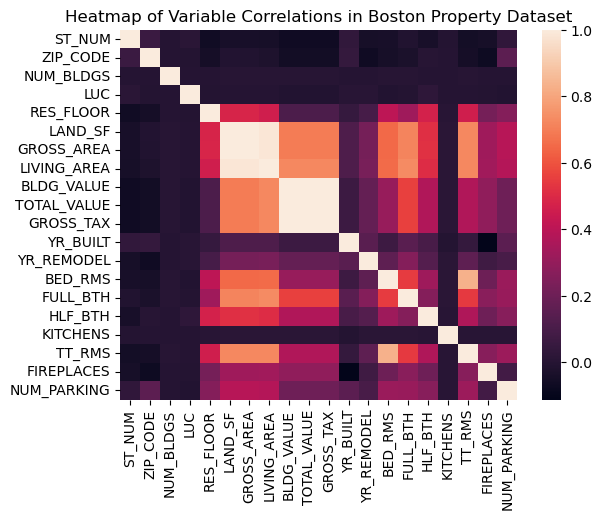

In [24]:
#lets see which numeric variables are correlated with property value
#need to drop land value because it probably also plays a part in property value - also its 0 for everythhing 
complete_housing['BLDG_SEQ'].unique()
complete_housing['LAND_VALUE'].unique()
#grabbing all the numeric variables
complete_housing_num = complete_housing.drop(columns= ['BLDG_SEQ', 'LAND_VALUE', 'PID', 'CM_ID', 'GIS_ID'])

#creating a correlation matrix 
housing_corr = complete_housing_num.corr(numeric_only= True)

#creating the heatmap of the correlation matrix 
sns.heatmap(housing_corr)
plt.title('Heatmap of Variable Correlations in Boston Property Dataset')
plt.show()

We can see from this output that several variables are strongly correlated with one another. For example, building and total value seem to be strongly correlated with gross area, which is not surprising. However, I am surprised that neither bedrooms nor the year a property was remodeled have a strong correlation with the total property value.

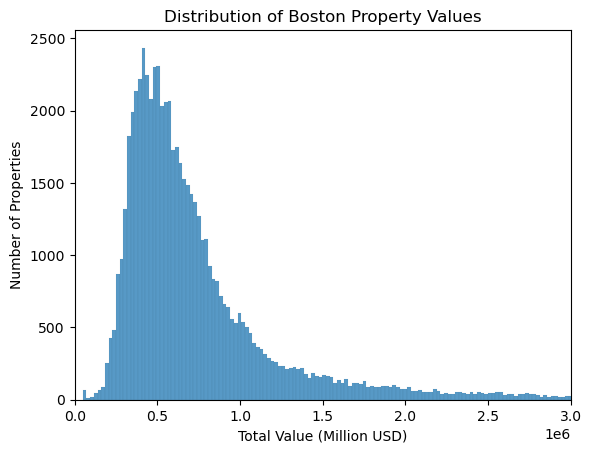

In [26]:
#need to cut out the outliers to visualize better, so I will limit to 3 million
threshold = 3000000

sns.histplot(data = complete_housing, x = 'TOTAL_VALUE')
plt.title('Distribution of Boston Property Values')
plt.xlabel('Total Value (Million USD)')
plt.ylabel('Number of Properties')
plt.xlim(0,threshold)
plt.show()

When I plotted the data initally, the distribution was heavily skewed to the left due to outliers. I decided to limit the x-axis at 3 million so that I could view the distribution easier. However, it still appears skewed to the left with a mode around $500,000. 

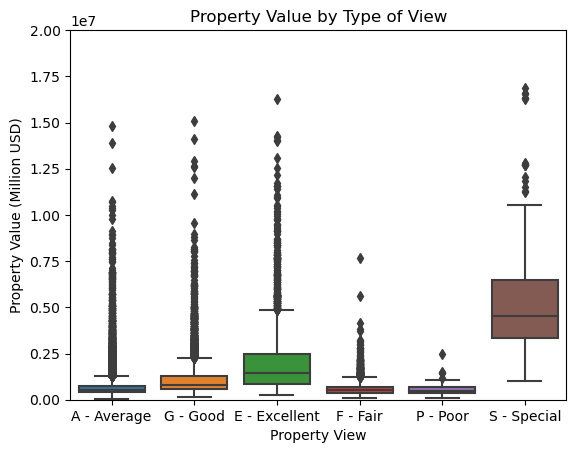

In [28]:
#want to see how property value differs by views (boxplot)
sns.boxplot(data = complete_housing, 
            x = 'PROP_VIEW', 
            y = 'TOTAL_VALUE')
plt.title('Property Value by Type of View')
plt.xlabel('Property View')
plt.ylabel('Property Value (Million USD)')
plt.ylim(0,20000000)
plt.show()

Based on the distribution of property value by type of view, it is clear that the type of view influences the overall property value. For example, the properties with poor and fair views have the lowest average property value, while those with a "special" view have a significantly higher average compared to the other groups. 

In [30]:
#dealing with zip code- need some way to capture location/neighborhood
complete_housing['ZIP_CODE'].unique()

#looked it up, and all the zip codes in boston start with 0, so need to adjust zip code values accordingly 

complete_housing['ZIP_CODE'] = complete_housing['ZIP_CODE'].astype('int').astype('str')
#need to add a 0 at the front and then remove the period. 
complete_housing['ZIP_CODE'] = complete_housing['ZIP_CODE'].map(lambda x: x.zfill(5))
#now I can create a dummy column for each zip code 
#complete_housing['ZIP_CODE'].unique()


In [31]:
#accessing a geojson with zip codes
url = 'https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/ma_massachusetts_zip_codes_geo.min.json'
with urlopen(url) as response:
    zipcodes = json.load(response)

In [32]:
#filter data to make map more reasonable 
no_outliers = complete_housing[complete_housing['TOTAL_VALUE'] <= threshold]

#calculate median for each group
#doing median vs mean so as not to have outliers throw off the information as much 
median_zip= no_outliers.groupby('ZIP_CODE')['TOTAL_VALUE'].median().reset_index()

In [33]:
#plot choropleth of median property value by zip code 
fig = px.choropleth(
                    median_zip,
                    geojson = zipcodes,
                    locations = 'ZIP_CODE',
                    featureidkey = "properties.ZCTA5CE10",
                    color = 'TOTAL_VALUE', 
                    scope = 'usa', 
                    labels={'TOTAL_VALUE': 'Median Property Value (in USD)', 'ZIP_CODE': 'Zip Code'}, 
                    title = 'Boston Property Values by Zip Code'
                   )
fig.update_geos(fitbounds="locations", visible=False)
#fig.title('Property Values Around Boston Massechussetes')

fig.show()

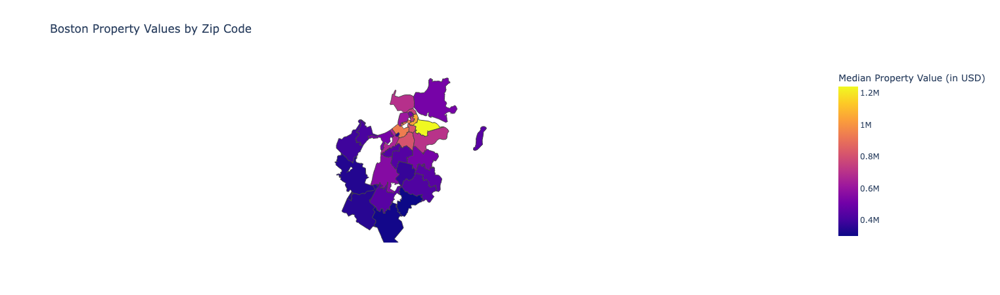

In [34]:
#so that this shows up in html, including the png of choropleth from code above.
Image('choropleth.png')


The distribution of property values seems to be skewed to the right, with several outliers. These are likely larger commercial buildings compared to the other homes and apartments that are also included in this dataset. When we look at the map to see if the median property value varies by zip code, we can see that it does. After looking into what areas these zip codes represent, it is clear that some of the more affluent neighborhoods have a higher median property value.

## Splitting the Data

Our target variable is TOTAL_VALUE since we are trying to predict the value of a property. Therefore, this is our Y.

For our X set, there are a few columns we do not need at all:
- Owner's name and the owner's mail address both serve as identifiers for the property. We need the model to learn how to predict home value without these clues, therefore, we will exclude these variables from our X set.
- LU_DESC is a description of the land use, but we already get this from the LU variable, so it is redundant to include both.

Additionally, some columns function as identifiers, so we will need to remove these in order for the models to properly learn how to predict property values. The columns that function as ids are:
CM_ID, GIS_ID, ST_NUM, ST_NAME, BLDG_SEQ, OWNER, and OWNER_MAIL_ADDRESS

Lastly, some variables may be a direct function of our y variable, so I cannot use them in our X set. These variables are land and building values.

I will include all other variables in the X set.



In [35]:
y = complete_housing['TOTAL_VALUE']
X = complete_housing.drop(columns = ['TOTAL_VALUE', 'OWNER', 'OWNER MAIL ADDRESS', 
                                    'CM_ID', 'GIS_ID', 'ST_NUM', 'ST_NAME', 'BLDG_SEQ', 'LU_DESC', 'BLDG_VALUE', 'LAND_VALUE'])

## Encoding the Data
This dataset is a mix of categorical and quantitative variables. In order to run our models, all of the data must be represented numerically. Therefore, we need to encode some columns. Since there are no ordinal categorical variables, I will one-hot-encode the categorical variables (create dummy columns for each value of the dataset). 

In [37]:
#checking the categorical columns
categorical_columns = X.select_dtypes(include=['object', 'category']).columns.tolist()
#categorical_columns
#complete_housing[categorical_columns].head()

Several columns need to be one-hot encoded since they do not have any order to them. 
- columns to be one-hot encoded
    - LU
    - BLDG_TYPE
    - ROOF_STRUCTURE, 
    - ROOF_COVER
    - INT_WALL
    - EXT_FNISHED
    - INT_COND
    - EXT_COND
    - OVERALL_COND
    - HEAT_TYPE
    - AC_TYPE
    - BTHRM_STYLE1
    - BTHRM_STYLE2
    - BTHRM_STYLE3
    - KITCHEN_TYPE
    - KITCHEN_STYLE1
    - KITCHEN_STYLE2
    - KITCHEN_STYLE3
    - PROP_VIEW

- One column needs to be turned into binary 1/0: 
    -  own_occ: residential exemption: yes or no, needs to be 1 and 0

In [38]:
#dealing with zip code- need some way to capture location/neighborhood
X['ZIP_CODE'].unique()

#looked it up, and all the zip codes in boston start with 0, so need to adjust zip code values accordingly 

X['ZIP_CODE'] = X['ZIP_CODE'].astype('int').astype('str')
#need to add a 0 at the front and then remove the period. 
X['ZIP_CODE'] = X['ZIP_CODE'].map(lambda x: x.zfill(5))
#now I can create a dummy column for each zip code 
#X['ZIP_CODE'].unique()


In [39]:
#now we create the dummy columns/one hot encode

#now I need to change the columns that are yes/no to 1/0
#complete_housing['OWN_OCC'].unique()
X['OWN_OCC'] = X['OWN_OCC'].replace({'Y': 1, 'N': 0})



#grab them all except the one that is binary
categorical_columns = [i for i in categorical_columns if i != 'OWN_OCC']


#creating a dummy df using get_dummies and dropping the first so there is a reference group
dummies = pd.get_dummies(X[categorical_columns], 
                               drop_first= True)

#join the 2 dfs back together 
X = pd.concat([X, dummies], axis=1, join = 'inner')

#now drop the columns that I changed to dummy vars 
X = X.drop(columns = categorical_columns)


## Train and Test Split
To split my data, I will use the traditional 80/20 split. Additionally, since I will be using some models that require us to standardize our data (the elastic net specifically), I will use a standard scaler on all of my X data. This will ensure I am using consistent data across all of my models.

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 12, test_size= .2)

In [41]:
#need to standardize my data 
scaler = StandardScaler()

#for the training set
X_train_scaled = scaler.fit_transform(X_train)

#for the testing set 
X_test_scaled = scaler.transform(X_test)

## Model Tuning and Evaluation

I will now train four models. My first model, a linear regression, will serve as my baseline model. I will then train a regularized regression (an elastic net specifically), a random forest, and gradient boosting machines (GBM). I will use cross-validation to tune and select my models. I will then plug my test set into the chosen model and evaluate its performance.

For hyperparameter tuning, I am only going to use 5-fold cross-validation (CV) to cut down on time complexity. However, when I use the CV score to get the average mean squared error (MSE), I will use 10 fold.

In terms of evaluation metrics, I will judge my model's performance primarily based on the MSE.


In [52]:
#initialize model
lr = LinearRegression()

#get a cross val score for this baseline model so that I can compare performance across models 
#going to do a cv with 10 folds 
cv_lr1 = cross_val_score(lr, X_train_scaled, y_train, cv = 10, scoring = 'neg_mean_squared_error')

#print the mean cross val score and standard deviation 
print('Average MSE: ', round(np.abs(cv_lr1.mean()), 2))
print('Standard Deviation: ', round(cv_lr1.std(), 2))

Average MSE:  1.4207807181099243e+23
Standard Deviation:  2.5780144470951872e+23


In [43]:
#initiate the model
net = ElasticNet(random_state = 12)


alphas = [.1, .2, .5, .8]
l1 = np.arange(0.0, 1.0, .25)
#define the parameters we need to tune 
#for elastic net the main ones are the alpha (the lambda penalty) and the l1 ratio (how much of lasso to use)
net_param_grid = {'alpha' : alphas, 
                  'l1_ratio': l1}

net_grid = GridSearchCV(net, net_param_grid, cv=5, scoring= 'neg_mean_squared_error') 
net_grid.fit(X_train_scaled, y_train) 

#save the tuned model
tuned_net = net_grid.best_estimator_

print(net_grid.best_params_)


{'alpha': 0.1, 'l1_ratio': 0.75}


In [53]:
#get an average cross val score for the elastic net
cv_net = cross_val_score(tuned_net, X_train_scaled, y_train, cv = 10, scoring = 'neg_mean_squared_error')
print('Average MSE: ', round(np.abs(cv_net.mean()), 2))
print('Standard Deviation of MSE: ', round(cv_net.std(), 2))

Average MSE:  2132615401.43
Standard Deviation of MSE:  1015621526.98


As we can see from the output, the optimal parameters are to have an l1 ratio of .75 and an alpha (penalty) of .1. The average MSE for this model is much lower than that of the plain linear regression. However, the standard deviation is very large.


In [55]:
#now for the random forest model
#initialize it 
rf = RandomForestRegressor(random_state = 12)

#define the hyperparameters to tune 
trees = list(range(100, 500, 100))

rf_param_grid = {'n_estimators': trees, 
               'max_features': ['sqrt', 'log2'], 
               }
#fit the grid search 
rf_grid = GridSearchCV(rf, rf_param_grid, cv=5, scoring= 'neg_mean_squared_error') 
rf_grid.fit(X_train_scaled, y_train) 

#get the best model and best parameters, see how it performed

tuned_rf = rf_grid.best_estimator_

print(rf_grid.best_params_)


{'max_features': 'sqrt', 'n_estimators': 100}


In [56]:
#get an average cross val score for the random forest
cv_rf = cross_val_score(tuned_rf, X_train_scaled, y_train, cv = 10, scoring = 'neg_mean_squared_error')
print('Average MSE: ', round(np.abs(cv_rf.mean()) ,2))
print('Standard Deviation: ', round(cv_rf.std() ,2))

Average MSE:  28461517378.76
Standard Deviation:  41534621472.04


We can see from this output that for the random forest model, the best combination of hyperparameters is having n_estimators = 100 (so 100 trees) and using the square root to determine the max_features at each split. In terms of how this model performed, the average MSE and the standard deviation of the MSE are larger compared to the elastic net.

In [57]:
#And now for the gradient boost model
#initiate
boost = GradientBoostingRegressor(random_state = 12)

#define teh parameters to tune
trees = list(range(100, 500, 100))
subs_range = [.8, .9, 1.0]

#generally ranges from 8 to 32 so I am choosing these values 
depth = [3, 5, 8, 12, 16]


gb_param_grid = {'n_estimators': trees, 
               'max_features': ['sqrt', 'log2'],
               'max_depth' : depth,
               'subsample' : subs_range
               }
#fit the grid search 
gb_grid = GridSearchCV(boost, gb_param_grid, cv=5, scoring= 'neg_mean_squared_error') 
gb_grid.fit(X_train_scaled, y_train) 

#get the best model and best parameters
tuned_gb = gb_grid.best_estimator_

#print the best parameters
print(gb_grid.best_params_)

{'max_depth': 5, 'max_features': 'sqrt', 'n_estimators': 400, 'subsample': 0.8}


In [59]:
#get an average cv score for the GBM
cv_gb = cross_val_score(tuned_gb, X_train_scaled, y_train, cv = 10, scoring = 'neg_mean_squared_error')
print('Average MSE: ', round(np.abs(cv_gb.mean()), 2))
print('Standard Deviation: ', round(cv_gb.std(), 2))

Average MSE:  18679843162.93
Standard Deviation:  21982653887.39


We can see from this output that the optimal parameters for model performance are n_estimators = 400, a subsample of 80%, a max_depth of 5, and max_features being chosen with sqrt. In terms of how this model performed, the GBM did slightly better than the random forest, but the standard deviation remains large. However, the elastic net seems to have performed the best overall. 

## Model Selection
#### Final Model: Elastic Net 

In [69]:
#make a table showing the percent difference in MSE for every other model compared to the elastic net
#saving the average mse as their own variables
avg_mse_lin = np.abs(cv_lr1.mean())
avg_mse_net = np.abs(cv_net.mean())
avg_mse_rf = np.abs(cv_rf.mean())
avg_mse_gbm = np.abs(cv_gb.mean())

#create a dictionary
mse_scores = {
    'Linear Regression': avg_mse_lin,
    'Elastic Net': avg_mse_net,
    'Random Forest': avg_mse_rf,
    'Gradient Boosting Machine': avg_mse_gbm
}

top_model = min(mse_scores, key=mse_scores.get)
top_mse = mse_scores[top_model]

#calculate percent difference from best model
percent_diff = {model: round(((mse - top_mse) / top_mse) * 100) for model, mse in mse_scores.items()}

#create a data frame
df_percent_diff = pd.DataFrame(percent_diff.items(), columns=['Model', 'Percent Difference'])

#add a percent sign
df_percent_diff['Percent Difference'] = df_percent_diff['Percent Difference'].apply(lambda x: f"{x:.2f}%")


custom_order = ['Linear Regression', 'Random Forest', 'Gradient Boosting Machine', 'Elastic Net']  

#Create custom order since the percent difference col is now a string 
df_percent_diff['Model'] = pd.Categorical(df_percent_diff['Model'], categories=custom_order, ordered=True)


# Display the table
print(df_percent_diff.sort_values(by = 'Model'))


                       Model    Percent Difference
0          Linear Regression  6662151633906791.00%
2              Random Forest              1235.00%
3  Gradient Boosting Machine               776.00%
1                Elastic Net                 0.00%


After looking at the average CV score for 10-fold cross-validation (using MSE as our primary evaluation metric), I will choose the elastic net as my final model. Not only did this model have the smallest average MSE, but it also had the smallest standard deviation. This indicates it is the most consistent model among the four. We can also see from the table above the percent difference in error for each model compared to the elastic net. The linear regression had the largest percent difference, but this is not surprising as it was the baseline model and we did not tune it at all. I will now plug the test set into the elastic net (my final model) and evaluate its performance.

In [61]:
#Now I will plug in the test set
#predict for the test set 
y_pred_net = tuned_net.predict(X_test_scaled)

#print out performance 
print('Test MSE: ', round(mean_squared_error(y_test, y_pred_net), 2))

Test MSE:  1707514414.27


This model performed very well on our test set; the MSE was the lower than the average MSE of all of the previous models. 

## Conclusion 

For this project, I tested four different models. I used a plain linear regression as my baseline, a regularized regression model—specifically an elastic net—a random forest, and a gradient boosting machine (GBM). I used 5-fold cross-validation to hyperparameter tune my models. Once I had the optimal parameters for each model, I ran 10-fold cross-validation and took the average MSE and the standard deviation of the MSE. After performing this 10-fold cross-validation, the best model turned out to be the elastic net. Finally, I plugged my test set into the tuned elastic net model and evaluated its performance. The testing MSE was 1707514414.27 (lower than the average MSE for every model, even the elastic net). Therefore, my final model for predicting Boston property values is an elastic net.
